# Upper Green PEST Pilot Point Setup

In [6]:
%matplotlib inline
import os, shutil
import sys
sys.path.append("..")
import numpy as np
from IPython.display import Image
import pandas as pd
import matplotlib.pyplot as plt

import flopy as flopy
import pyemu
import shapefile #the pyshp module
from pyemu.pst.pst_utils import SFMT,IFMT,FFMT,pst_config

# <span style="color:blue">1. Set up pilot points network for MB model some</span>.

There are multiple approaches to implementing pilot points with PEST++.  

In this class, we will use some kick-ass pyemu sweetness

### 1.1. Set up zones for where pilot points will be interpolated

We can have pilot point networks in multiple zones. In this case, we will make a simple zone file using `IBOUND` such that all active cells are in the same interpolation zone.

In [2]:
working_dir = 'D:/Projects/Watersheds/Gunnison/Analysis/apexmf_models/apexmf_01/apexmf_042621/APEX-MODFLOW/MODFLOW'
mname = "mf_1000.nam"
os.chdir(working_dir)




In [4]:
# m = flopy.modflow.Modflow.load(fs.MODEL_NAM,model_ws=wd,load_only=[]) #<-- load only prevents reading ibound
m = flopy.modflow.Modflow.load(
            mname,
            model_ws=working_dir
            )
m.check()

Errors and/or Warnings encountered.
Errors and/or Warnings encountered.

mf_1000 MODEL DATA VALIDATION SUMMARY:
  14594 Warnings:
    OC package: action(s) defined in OC stress_period_data ignored as they are not part the stress periods defined by DIS
    RCH package: Mean R/T ratio < checker warning threshold of 2e-08 for 1 stress periods
    RCH package: Variable NRCHOP set to value other than 3
    RIV package: BC in inactive cell
    UPW package: specific yield values below checker threshold of 0.01

  Checks that passed:
    Unit number conflicts
    Compatible solver package
    DIS package: zero or negative thickness
    DIS package: thin cells (less than checker threshold of 1.0)
    DIS package: nan values in top array
    DIS package: nan values in bottom array
    BAS6 package: isolated cells in ibound array
    BAS6 package: Not a number
    UPW package: zero or negative horizontal hydraulic conductivity values
    UPW package: zero or negative vertical hydraulic conductivi

<AxesSubplot:title={'center':'ibound_layer_0'}>

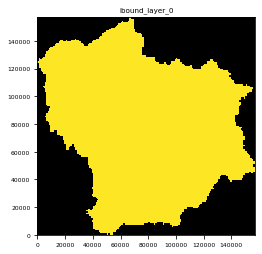

In [4]:
m.bas6.ibound[0].plot()

### 1.2. It is for when pilot points don't exist. We don't want pilot points or care about HK values in inactive cells, but we do need values in constant heads

We are going to use a pyemu helper function to setup pilot points are cell centers for active cells.

In [6]:
# Create pilot points as a shapefile
# we want hk pilot points in the top layer...
prefix_dict = {0:["hk0"]}
df_pp_hk = pyemu.pp_utils.setup_pilotpoints_grid(ml=m,
                                              prefix_dict=prefix_dict,
                                              pp_dir=working_dir,
                                              tpl_dir=working_dir,
                                              every_n_cell=10,
                                              shapename='pp_hk.shp')
# pp_file = os.path.join(working_dir,"sypp.dat")
# assert os.path.exists(pp_file)


### 1.3. Create dataframe from shapefile

#### **1.3.1. Change Shapefile name**

In [33]:
# change shapefile and file name
shpwd = working_dir
shp = 'pp_sy.shp'
shp_changed = 'sy0pp.shp'
ppf = shp_changed[:-3] + 'dat'
ppf

'sy0pp.dat'

## **1.3.2. Shapefile to Dataframe**

In [34]:
#read file, parse out the records and shapes
shapefile_path = os.path.join(shpwd, shp)
sf = shapefile.Reader(shapefile_path)

#grab the shapefile's field names (omit the first psuedo field)
fields = [x[0] for x in sf.fields][1:]
records = sf.records()
shps = [s.points for s in sf.shapes()]

#write the records into a dataframe
shapefile_dataframe = pd.DataFrame(columns=fields, data=records)

#add the coordinate data to a column called "coords"
shapefile_dataframe = shapefile_dataframe.assign(coords=shps)

pp_df = shapefile_dataframe.sort_values(by=['name'])
print(pp_df)

        name        x         y  zone  parval1  k    i   j               tpl  \
0    pp_0000  65500.0  151500.0   1.0      1.0  0    5  65  ~    sy0000    ~   
1    pp_0001  45500.0  141500.0   1.0      1.0  0   15  45  ~    sy0001    ~   
2    pp_0002  55500.0  141500.0   1.0      1.0  0   15  55  ~    sy0002    ~   
3    pp_0003  65500.0  141500.0   1.0      1.0  0   15  65  ~    sy0003    ~   
4    pp_0004  75500.0  141500.0   1.0      1.0  0   15  75  ~    sy0004    ~   
..       ...      ...       ...   ...      ... ..  ...  ..               ...   
142  pp_0142  55500.0   11500.0   1.0      1.0  0  145  55  ~    sy0142    ~   
143  pp_0143  65500.0   11500.0   1.0      1.0  0  145  65  ~    sy0143    ~   
144  pp_0144  75500.0   11500.0   1.0      1.0  0  145  75  ~    sy0144    ~   
145  pp_0145  85500.0   11500.0   1.0      1.0  0  145  85  ~    sy0145    ~   
146  pp_0146  95500.0   11500.0   1.0      1.0  0  145  95  ~    sy0146    ~   

     parnme  ...                       

In [35]:
os.chdir(working_dir)

In [36]:
os.getcwd()

'D:\\Projects\\Watersheds\\Gunnison\\Analysis\\apexmf_models\\apexmf_042621\\APEX-MODFLOW\\MODFLOW'

In [37]:
pyemu.utils.pp_utils.write_pp_file(ppf, pp_df)
# pyemu.utils.pp_utils.pilot_points_to_tpl('hahaha.dat')

In [38]:
PP_FMT = {"name": SFMT, "x": FFMT, "y": FFMT, "zone": IFMT, "tpl": SFMT,
          "parval1": FFMT}
def pp_to_tpl(pp_file, tpl_file=None):
    names = pp_df['parnme'].tolist() # for hk
    # names = pp_df['sypar'].tolist() # for sy  
#     names = pp_df['parnme'].tolist() # for river conductance      
    if tpl_file is None:
        tpl_file = pp_file + ".tpl"    
    tpl_entries = ["~    {0}    ~".format(name) for name in names]
    pp_df.loc[:,"tpl"] = tpl_entries
    pp_df.loc[:,"parnme"] = names


    f_tpl = open(tpl_file,'w')
    f_tpl.write("ptf ~\n")
    f_tpl.write(pp_df.to_string(col_space=0,
                              columns=["name","x","y","zone","tpl"],
                              formatters=PP_FMT,
                              justify="left",
                              header=False,
                              index=False) + '\n')    
pp_to_tpl(ppf)

Let's look at ``pp_df`` - it has a lot of useful info

In [39]:
pp_df

,name,x,y,zone,parval1,k,i,j,tpl,parnme,...,pp_filenam,pargp,partrans,parchglim,parlbnd,parubnd,scale,offset,dercom,coords
0,pp_0000,65500.0,151500.0,1.0,1.0,0,5,65,~ sy0000 ~,sy0000,...,D:/Projects/Watersheds/Gunnison/Analysis/apexmf_mo,sy0,log,factor,1.000000e-10,1.100000e+10,1.0,0.0,1,"[[-976679.6636818679, 1857642.1899867258]]"
1,pp_0001,45500.0,141500.0,1.0,1.0,0,15,45,~ sy0001 ~,sy0001,...,D:/Projects/Watersheds/Gunnison/Analysis/apexmf_mo,sy0,log,factor,1.000000e-10,1.100000e+10,1.0,0.0,1,"[[-996679.6636818679, 1847642.1899867258]]"
2,pp_0002,55500.0,141500.0,1.0,1.0,0,15,55,~ sy0002 ~,sy0002,...,D:/Projects/Watersheds/Gunnison/Analysis/apexmf_mo,sy0,log,factor,1.000000e-10,1.100000e+10,1.0,0.0,1,"[[-986679.6636818679, 1847642.1899867258]]"
3,pp_0003,65500.0,141500.0,1.0,1.0,0,15,65,~ sy0003 ~,sy0003,...,D:/Projects/Watersheds/Gunnison/Analysis/apexmf_mo,sy0,log,factor,1.000000e-10,1.100000e+10,1.0,0.0,1,"[[-976679.6636818679, 1847642.1899867258]]"
4,pp_0004,75500.0,141500.0,1.0,1.0,0,15,75,~ sy0004 ~,sy0004,...,D:/Projects/Watersheds/Gunnison/Analysis/apexmf_mo,sy0,log,factor,1.000000e-10,1.100000e+10,1.0,0.0,1,"[[-966679.6636818679, 1847642.1899867258]]"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
142,pp_0142,55500.0,11500.0,1.0,1.0,0,145,55,~ sy0142 ~,sy0142,...,D:/Projects/Watersheds/Gunnison/Analysis/apexmf_mo,sy0,log,factor,1.000000e-10,1.100000e+10,1.0,0.0,1,"[[-986679.6636818679, 1717642.1899867258]]"
143,pp_0143,65500.0,11500.0,1.0,1.0,0,145,65,~ sy0143 ~,sy0143,...,D:/Projects/Watersheds/Gunnison/Analysis/apexmf_mo,sy0,log,factor,1.000000e-10,1.100000e+10,1.0,0.0,1,"[[-976679.6636818679, 1717642.1899867258]]"
144,pp_0144,75500.0,11500.0,1.0,1.0,0,145,75,~ sy0144 ~,sy0144,...,D:/Projects/Watersheds/Gunnison/Analysis/apexmf_mo,sy0,log,factor,1.000000e-10,1.100000e+10,1.0,0.0,1,"[[-966679.6636818679, 1717642.1899867258]]"
145,pp_0145,85500.0,11500.0,1.0,1.0,0,145,85,~ sy0145 ~,sy0145,...,D:/Projects/Watersheds/Gunnison/Analysis/apexmf_mo,sy0,log,factor,1.000000e-10,1.100000e+10,1.0,0.0,1,"[[-956679.6636818679, 1717642.1899867258]]"


So cool, we now defined pilot points as a set of spatially distributed parameters...but how do go from pilot points to the model input HK array? Answer: geostatistics.  We need to calculate the geostatistical factors (weights) used to form the interpolated value for the HK value at each model cell - its a spatially-weighted combination of pilot point values

# <span style="color:blue">2. Geostatistics</span>

## Need to create Kriging factors and regularization inputs
Following the guidelines in _Approaches to Highly Parameterized Inversion: Pilot-Point Theory, Guidelines, and Research Directions_ https://pubs.usgs.gov/sir/2010/5168/

### First we need to define a couple geostatistical structures (e.g. variograms)

From _PEST Groundwater Data Utilities Part A: Overview_ page 43, there are 4 acceptable variogram types:

 1. *Spherical*  
### $\gamma\left(h\right)=c\times\left[1.5\frac{h}{a}-0.5\frac{h}{a}^3\right]$ if $h<a$
### $\gamma\left(h\right)=c$ if $h \ge a$  
     
 2. *Exponential*  
### $\gamma\left(h\right)=c\times\left[1-\exp\left(-\frac{h}{a}\right)\right]$  
     
 3. *Gaussian*  
### $\gamma\left(h\right)=c\times\left[1-\exp\left(-\frac{h^2}{a^2}\right)\right]$  
 
 4. *Power*  
### $\gamma\left(h\right)=c\times h^a$
     
 The number refers to `VARTYPE`. `BEARING` and `ANISOTROPY` only apply if there is a principal direction of anisotropy. $h$ is the separation distance, and $a$ is the range, expressed with the `A` parameter.


### First, let's create ``variogram`` and ``GeoStruct`` objects.  

These describe how HK varies spatailly, remember?

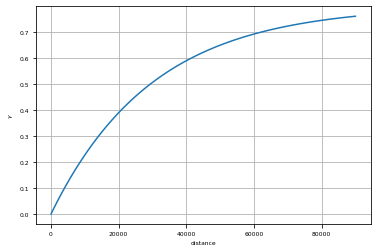

In [40]:
v = pyemu.geostats.ExpVario(contribution=0.8,a=30000, bearing=0)
gs = pyemu.geostats.GeoStruct(variograms=v,nugget=0.0)
ax = gs.plot()
ax.grid()
# ax.set_ylim(0,2.0)

Now, let's get an ``OrdinaryKrige`` object, which needs the ``GeoStruct`` as well as the x, y, and name of the pilot point locations (which happens to be in that really cool ``df_pp`` instance)

In [41]:
ok = pyemu.geostats.OrdinaryKrige(gs,pp_df)

Once the ``OrdinaryKrige`` is created, we need to calculate the geostatistical interpolation factors for each model cell.  We do this with the ``.calc_factors_grid()`` method: it needs to know about the model's spatial orientation and also accepts some optional arguments:

### Kriging Processing... it takes time

In [42]:
df = ok.calc_factors_grid(m.sr,
#                           var_filename=pst_name.replace(".pst",".var.ref"),
                          var_filename= ppf[:-3] + "var.ref",                          
                          minpts_interp=1,maxpts_interp=50,
                          search_radius=1000000000000.0)


starting interp point loop for 24649 points
took 95.119193 seconds


One of the really cool things about geostatistics is that it gives you both the interpolation (factors), but also gives you the uncertainty in the areas between control (pilot) points.  Above, we wrote this uncertainty information to an array that has the same rows and cols as the model grid - this array is very useful for understanding the function of the variogram.

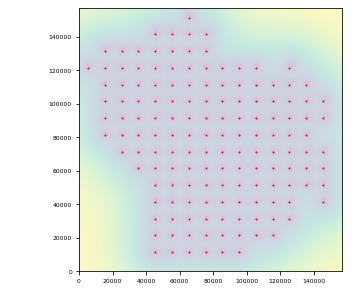

In [27]:
# arr_var = np.loadtxt(pst_name.replace(".pst",".var.ref"))
arr_var = np.loadtxt(ppf[:-3] + "var.ref")
ax = plt.subplot(111,aspect="equal")
p = ax.imshow(arr_var,extent=m.sr.get_extent(),alpha=0.25)
plt.colorbar(p)
plt.tight_layout()
ax.scatter(pp_df.x,pp_df.y,marker='.',s=4,color='r')

We see that at the pilot point locations (red dots), the uncertainty in the geostats is minimal...as expected. The call to ``.calc_factors_grid()`` also returns a ``DataFrame`` which has useful info - lets look:

In [28]:
df

,x,y,idist,inames,ifacts,err_var
0,500.0,156500.0,"[29154.759474226503, 35355.33905932738, 35355.33905932738, 38078.86552931954, 43011.626335213135...","[pp_0005, pp_0012, pp_0006, pp_0013, pp_0014, pp_0007, pp_0001, pp_0024, pp_0015, pp_0025, pp_00...","[0.31450174906694955, 0.2129712041386582, 0.08353367735219505, -0.054790741391935315, -0.0426225...",61.747387
1,1500.0,156500.0,"[28653.097563788804, 34655.44690232691, 35227.82990761707, 37696.15364994153, 42201.895692018385...","[pp_0005, pp_0006, pp_0012, pp_0013, pp_0007, pp_0014, pp_0001, pp_0024, pp_0015, pp_0008, pp_00...","[0.3191656705351305, 0.08743871659110526, 0.208003540416375, -0.05509850635758755, 0.03528489289...",61.429083
2,2500.0,156500.0,"[28178.00560721074, 33970.575502926054, 35128.33614050059, 37336.30940518894, 41400.483088968904...","[pp_0005, pp_0006, pp_0012, pp_0013, pp_0007, pp_0014, pp_0001, pp_0024, pp_0015, pp_0008, pp_00...","[0.32345101737717286, 0.09155827795541263, 0.2027665157662295, -0.05538546822316098, 0.036798668...",61.112036
3,3500.0,156500.0,"[27730.849247724094, 33301.65161069343, 35057.09628591621, 37000.0, 40607.8810084939, 41340.0532...","[pp_0005, pp_0006, pp_0012, pp_0013, pp_0007, pp_0014, pp_0001, pp_0024, pp_0015, pp_0008, pp_00...","[0.3273005691745574, 0.09589101505832412, 0.19728311919967512, -0.05564846021113557, 0.038421615...",60.797220
4,4500.0,156500.0,"[27313.000567495325, 32649.655434629014, 35014.28280002319, 36687.87265568828, 39824.61550347975...","[pp_0005, pp_0006, pp_0012, pp_0013, pp_0007, pp_0014, pp_0001, pp_0024, pp_0015, pp_0008, pp_00...","[0.3306561297714035, 0.10043229147334869, 0.19157949503818694, -0.055883715361121286, 0.04015975...",60.485630
...,...,...,...,...,...,...
24644,152500.0,500.0,"[41109.60958218893, 41593.26868617084, 42544.09477236529, 48270.07354458868, 49091.75083453431, ...","[pp_0132, pp_0123, pp_0140, pp_0131, pp_0122, pp_0139, pp_0113, pp_0112, pp_0121, pp_0130, pp_01...","[0.15489168183145416, 0.23809973907965562, 0.1789311239363683, -0.03161232751991236, -0.00886320...",67.017329
24645,153500.0,500.0,"[41773.19714841084, 41773.19714841084, 43416.58669218482, 49040.79934095691, 49648.76634922564, ...","[pp_0132, pp_0123, pp_0140, pp_0131, pp_0122, pp_0113, pp_0139, pp_0112, pp_0121, pp_0130, pp_01...","[0.15179327543690635, 0.23962616898655442, 0.17403719425169306, -0.030940125210774754, -0.008772...",67.226607
24646,154500.0,500.0,"[41976.18372363071, 42449.97055358225, 44294.4691807002, 49819.674828324605, 50219.518117958876,...","[pp_0123, pp_0132, pp_0140, pp_0131, pp_0122, pp_0113, pp_0139, pp_0112, pp_0121, pp_0130, pp_01...","[0.2408802067499329, 0.1486692415926344, 0.16933442047440728, -0.030272980265049213, -0.00869099...",67.429580
24647,155500.0,500.0,"[42201.895692018385, 43139.30922024598, 45177.42799230607, 50606.32371551998, 50803.54318352215,...","[pp_0123, pp_0132, pp_0140, pp_0131, pp_0122, pp_0113, pp_0139, pp_0112, pp_0121, pp_0130, pp_01...","[0.24184921302898107, 0.14552231089117434, 0.1647854010244372, -0.029608639021019324, -0.0086098...",67.637662


We see that there is one row for each model cell, and for each row, we see the distance, names, and weight for the "nearby" pilot points.  The interpolated value for cells that have a pilot point at their center only need one weight - 1.0 - and one pilot point.  Other cells are weighted combinations of pilot points.  Is this clear?  

### Now we need to save the factors (weights) to a special file that we will use later to quickly generate a new HK array from a set of pilot point values:

In [46]:
ok.to_grid_factors_file(ppf+".fac")

Just for demo purposes, lets generate ``random`` pilot point values and run them through the factors to see what the ``hk`` array looks like

In [47]:
# generate random values
pp_df.loc[:,"parval1"] = np.random.random(pp_df.shape[0])
# save a pilot points file
pyemu.pp_utils.write_pp_file(ppf,pp_df)

In [48]:
# interpolate the pilot point values to the grid
hk_arr = pyemu.utils.geostats.fac2real(ppf,factors_file=ppf+".fac",out_file=None)

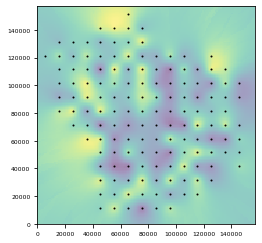

In [49]:
# plot
ax = plt.subplot(111,aspect='equal')
ax.imshow(hk_arr,interpolation="nearest",extent=m.sr.get_extent(),alpha=0.5)
ax.scatter(pp_df.x,pp_df.y,marker='.',s=4,color='k')

What happens if you recalculate the factors using one point for every cell? Change ``max_interp_pts`` to 1 in the ``calc_factors_grid()`` and rerun these cells...

### An aside on geostatistics and covariance matrices

The ``GeoStruct`` object above was used to interpolate from pilot point locations to each node in the grid.  But this same ``GoeStruct`` also has an important information regarding how the pilot points are related to each other spatially---that is, the ``GeoStruct`` object implies a covariance matrix.  Let's form that matrix 

In [21]:
cov = gs.covariance_matrix(pp_df.x,pp_df.y,pp_df.parnme)

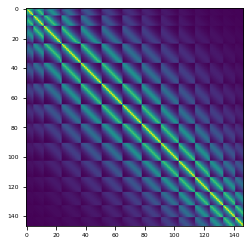

In [22]:
plt.imshow(cov.x)

In [23]:
cov.to_dataframe()

,hk0000,hk0001,hk0002,hk0003,hk0004,hk0005,hk0006,hk0007,hk0008,hk0009,...,hk0137,hk0138,hk0139,hk0140,hk0141,hk0142,hk0143,hk0144,hk0145,hk0146
hk0000,0.800000,0.379652,0.499300,0.573225,0.499300,0.132895,0.180170,0.240510,0.311626,0.379652,...,0.009977,0.009369,0.008592,0.007705,0.007175,0.007434,0.007523,0.007434,0.007175,0.006767
hk0001,0.379652,0.800000,0.573225,0.410734,0.294304,0.278807,0.379652,0.499300,0.573225,0.499300,...,0.011802,0.010499,0.009138,0.007797,0.010499,0.010365,0.009977,0.009369,0.008592,0.007705
hk0002,0.499300,0.573225,0.800000,0.573225,0.410734,0.202399,0.278807,0.379652,0.499300,0.573225,...,0.012955,0.011802,0.010499,0.009138,0.010365,0.010499,0.010365,0.009977,0.009369,0.008592
hk0003,0.573225,0.410734,0.573225,0.800000,0.573225,0.146195,0.202399,0.278807,0.379652,0.499300,...,0.013866,0.012955,0.011802,0.010499,0.009977,0.010365,0.010499,0.010365,0.009977,0.009369
hk0004,0.499300,0.294304,0.410734,0.573225,0.800000,0.105322,0.146195,0.202399,0.278807,0.379652,...,0.014451,0.013866,0.012955,0.011802,0.009369,0.009977,0.010365,0.010499,0.010365,0.009977
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
hk0142,0.007434,0.010365,0.010499,0.010365,0.009977,0.011802,0.012955,0.013866,0.014451,0.014653,...,0.278807,0.202399,0.146195,0.105322,0.573225,0.800000,0.573225,0.410734,0.294304,0.210878
hk0143,0.007523,0.009977,0.010365,0.010499,0.010365,0.010499,0.011802,0.012955,0.013866,0.014451,...,0.379652,0.278807,0.202399,0.146195,0.410734,0.573225,0.800000,0.573225,0.410734,0.294304
hk0144,0.007434,0.009369,0.009977,0.010365,0.010499,0.009138,0.010499,0.011802,0.012955,0.013866,...,0.499300,0.379652,0.278807,0.202399,0.294304,0.410734,0.573225,0.800000,0.573225,0.410734
hk0145,0.007175,0.008592,0.009369,0.009977,0.010365,0.007797,0.009138,0.010499,0.011802,0.012955,...,0.573225,0.499300,0.379652,0.278807,0.210878,0.294304,0.410734,0.573225,0.800000,0.573225


What do these numbers mean?  Why should you care?  Well, this covariance matrix plays an important role in uncertainty quantification, as well as in governing the way pilot point parameters are adjusted during calibration

# Build instruction files (Streamflow / Watertable)

### 1. Streamflow (output.rch)

In [1]:
sys.path.insert(0, 'D:/spark-brc_gits/apexmf_git/apexmf_pkgs')
# from apexmf_pst_pkgs import apexmf_pst_utils, apexmf_pst_par
import apexmf_pst_utils

flopy is installed in C:\Users\seonggyu.park\Miniconda3\envs\sm_pest\lib\site-packages\flopy


In [2]:
working_dir = 'D:/Projects/Watersheds/Gunnison/Analysis/calibration/apexmf_210601/apexmf_042621/APEX-MODFLOW'
os.chdir(working_dir)
wd = 'D:/Projects/Watersheds/Gunnison/Analysis/calibration/apexmf_210601/apexmf_042621/APEX-MODFLOW/MODFLOW'



In [3]:
# Create parm template file

sw_par = apexmf_pst_utils.parm_to_tpl_file()
sw_par

,0,1,2,3,4,5,6,7,8,9
0,1.50,2.,.5,0.9000,~p005~,0.500,0.990,20.000,20.000,20.000
1,-100.00,~p012~,2.0000,1.,~p015~,~p016~,~p017~,1.500,0.003,~p020~
2,10.00,0.90,~p023~,0.1000,~p025~,0.000,0.300,5.000,.01,1.100
3,0.30,1.00,2.5000,~p034~,0.9900,0.,0.200,1.000,.01,~p040~
4,0.50,~p042~,0.1500,~p044~,3.0000,0.500,1.000,0.000,~p049~,~p050~
5,~p051~,10.00,0.9000,0.6000,0.2000,0.900,1.000,0.600,0.100,7.000
6,~p061~,0.25,1.1000,1.0000,0.0010,3.000,10.000,0.500,0.500,1.
7,1.15,.05,0.5000,0.2000,0.8000,.05,0.000,10.000,1.000,.5
8,0.00,3.,0.5100,0.0001,0.0001,0.010,0.010,0.001,~p089~,~p090~
9,~p091~,~p092~,1.,1.,~p095~,1.,.9,1.,1.,.000548


### 1.1.1 Create river parameters (No river parameters for Gunnison)


In [67]:
# provide channel ids that will be used for calibration
subs = ['rg009', 'rg096', 'rg199', 'rg155', 'rg200']
apexmf_pst_par.create_riv_par(wd, subs)

'mf_riv.par' file has been exported to the MODFLOW working directory!


,parnme,chg_type,val
parnme,,,
rivcd_rg009,rivcd_rg009,unfchg,0.001
rivcd_rg096,rivcd_rg096,unfchg,0.001
rivcd_rg199,rivcd_rg199,unfchg,0.001
rivcd_rg155,rivcd_rg155,unfchg,0.001
rivcd_rg200,rivcd_rg200,unfchg,0.001
rivbot_rg009,rivbot_rg009,unfchg,0.001
rivbot_rg096,rivbot_rg096,unfchg,0.001
rivbot_rg199,rivbot_rg199,unfchg,0.001
rivbot_rg155,rivbot_rg155,unfchg,0.001


In [68]:
# create a template file for mf_riv.par file
apexmf_pst_utils.riv_par_to_template_file('mf_riv.par')

,parnme,chg_type,parval1,tpl
parnme,,,,
rivcd_rg009,rivcd_rg009,pctchg,0.001,~ rivcd_rg009 ~
rivcd_rg096,rivcd_rg096,pctchg,0.001,~ rivcd_rg096 ~
rivcd_rg199,rivcd_rg199,pctchg,0.001,~ rivcd_rg199 ~
rivcd_rg155,rivcd_rg155,pctchg,0.001,~ rivcd_rg155 ~
rivcd_rg200,rivcd_rg200,pctchg,0.001,~ rivcd_rg200 ~
rivbot_rg009,rivbot_rg009,unfchg,0.001,~ rivbot_rg009 ~
rivbot_rg096,rivbot_rg096,unfchg,0.001,~ rivbot_rg096 ~
rivbot_rg199,rivbot_rg199,unfchg,0.001,~ rivbot_rg199 ~
rivbot_rg155,rivbot_rg155,unfchg,0.001,~ rivbot_rg155 ~


In [69]:
# overwrite the river package file
apexmf_pst_par.riv_par(wd)

The original river package "gr_1000.riv" has been backed up...
gr_1000.riv file is overwritten successfully!


# 1.2. Build instruction files (streamflow / watertable / baseflow)
## 1.2.1. Streamflow (output.rch)

In [4]:
os.chdir(working_dir)

In [5]:
# file path
rch_file = 'SITE64.RCH'
# reach numbers that are used for calibration
subs = [21, 26, 64, 67, 84, 111]
# extract month_streamflow
apexmf_pst_utils.extract_month_str(rch_file, subs, '1/1/2007', '1/1/2011', '12/31/2017')

cha_021.txt file has been created...
cha_026.txt file has been created...
cha_064.txt file has been created...
cha_067.txt file has been created...
cha_084.txt file has been created...
cha_111.txt file has been created...
Finished ...


### 1.2.3. Create instruction files for each str_sim file using the 'streamflow.obd' file

In [4]:
import pandas as pd

In [10]:
# because we have 3 streamgages let's loop for them
# read streamobd and get column names
stf_obd = pd.read_csv(
                    'stf_mon.obd',
                    sep='\t',
                    index_col=0,
                    parse_dates=True,
                    na_values=[-999, '']
                    )
# stf_obd_c = stf_obd.resample('M').mean()
# stf_obd_c.to_csv('streamflow_m.obd', sep='\t', na_rep=-999, float_format='%.2f')
obds = stf_obd.columns.tolist()
# obds.remove('sub046')
# obds.remove('sub130')
print(obds)
sim_files = ['cha_{:03d}.txt'.format(x) for x in subs]
# sed_files = ['sed_{:03d}.txt'.format(x) for x in subs]
# sim_files = sim_files + sed_files
print(sim_files)

['sub0003', 'sub0004', 'sub0011', 'sub0012', 'sub0015', 'sub0021', 'sub0026', 'sub0036', 'sub0041', 'sub0042', 'sub0045', 'sub0050', 'sub0052', 'sub0055', 'sub0058', 'sub0061', 'sub0063', 'sub0064', 'sub0067', 'sub0070', 'sub0074', 'sub0082', 'sub0084', 'sub0088', 'sub0089', 'sub0092', 'sub0102', 'sub0108', 'sub0111', 'sub0114', 'sub0119', 'sub0123', 'sub0124', 'sub0127', 'sub0133', 'sub0141', 'sub0179', 'sub0193', 'sub0196', 'sub0209', 'sub0219']
['cha_021.txt', 'cha_026.txt', 'cha_064.txt', 'cha_067.txt', 'cha_084.txt', 'cha_111.txt']


In [12]:
obds = ['sub{:04d}'.format(x) for x in subs]
obds

['sub0021', 'sub0026', 'sub0064', 'sub0067', 'sub0084', 'sub0111']

In [13]:
# create instruction files for each sim file
for i in range(len(sim_files)):
    apexmf_pst_utils.stf_obd_to_ins(sim_files[i], obds[i], '1/1/2011', '12/31/2017', time_step='month')

cha_021.txt.ins file has been created...
cha_026.txt.ins file has been created...
cha_064.txt.ins file has been created...
cha_067.txt.ins file has been created...
cha_084.txt.ins file has been created...
cha_111.txt.ins file has been created...


# Get groundwater levels

In [5]:
wtdf = pd.read_excel("D:/Projects/Watersheds/Green/GIS/mf_obs_grids.dbf.xlsx", engine="openpyxl")
# get cal only
wtdf = wtdf.loc[wtdf.cal_counts > 0]
wtdf

,SITENO,cal_counts,val_counts,symbol,col,row,grid_id,elev_mf,UPPER_AQUI,name
0,413106109280001,2,0,cal,57,148,17256,1871.823260,1846.803260,wt17256
1,413131109281101,2,0,cal,57,148,17256,1871.823260,1846.803260,wt17256b
2,413134109274301,3,0,cal,58,148,17257,1881.017076,1851.267076,wt17257
3,413428109135201,3,0,cal,71,146,17036,1916.793190,1892.965690,wt17036
4,413454109133501,4,1,both,71,146,17036,1916.793190,1892.965690,wt17036b
...,...,...,...,...,...,...,...,...,...,...
121,425308109530901,1,0,cal,49,44,5080,2218.452355,2188.377355,wt05080
122,425606109570801,2,0,cal,46,40,4609,2229.128779,2197.783779,wt04609
123,425633110142401,3,0,cal,31,37,4243,2272.335217,2254.657717,wt04243
124,430322110003301,1,0,cal,45,31,3555,2346.089509,2324.842009,wt03555


In [5]:
# os.chdir(wd)
os.getcwd()

'D:\\Projects\\Watersheds\\Gunnison\\Analysis\\calibration\\apexmf_210601\\apexmf_042621\\APEX-MODFLOW'

In [8]:
# We do have watertable data now
# grid_ids = wtdf.grid_id.to_list()
grid_ids = [8489]

apexmf_pst_utils.extract_watertable_sim(grid_ids, '1/1/2007', '12/31/2017')

wt_8489.txt file has been created...
Finished ...


In [13]:
len(grid_ids)

100

In [9]:
obd_names = wtdf.name.to_list()

In [14]:
'wt{:05d}'.format(3087)


'wt03087'

In [10]:
for grid_id in (grid_ids):
    apexmf_pst_utils.mf_obd_to_ins('wt_{}.txt'.format(grid_id), 'g{:05d}'.format(grid_id), '1/1/2007', '12/31/2017')

wt_8489.txt.ins file has been created...


In [7]:
io_files = pyemu.helpers.parse_dir_for_io_files('.')
pst = pyemu.Pst.from_io_files(*io_files)
pyemu.helpers.pst_from_io_files(io_files[0], io_files[1], io_files[2], io_files[3], 'gns_dummy.pst')

# print(os.chdir(".."))
io_files

C:\Users\seonggyu.park\Miniconda3\envs\sm_pest\lib\site-packages\pyemu\pst\pst_utils.py:615: UserWarning: error processing instruction file cha_021.txt.ins, trying inschek: substring not found
  warnings.warn("error processing instruction file {0}, trying inschek: {1}".format(ins_file,str(e)))
C:\Users\seonggyu.park\Miniconda3\envs\sm_pest\lib\site-packages\pyemu\pst\pst_utils.py:615: UserWarning: error processing instruction file cha_026.txt.ins, trying inschek: substring not found
  warnings.warn("error processing instruction file {0}, trying inschek: {1}".format(ins_file,str(e)))
C:\Users\seonggyu.park\Miniconda3\envs\sm_pest\lib\site-packages\pyemu\pst\pst_utils.py:615: UserWarning: error processing instruction file cha_064.txt.ins, trying inschek: substring not found
  warnings.warn("error processing instruction file {0}, trying inschek: {1}".format(ins_file,str(e)))
error using inschek for instruction file cha_021.txt.ins:run() returned non-zero: 1
observations in this instructio

(['hk0pp.dat.tpl', 'PARM1501.DAT.tpl', 'sy0pp.dat.tpl'],
 ['hk0pp.dat', 'PARM1501.DAT', 'sy0pp.dat'],
 ['cha_021.txt.ins',
  'cha_026.txt.ins',
  'cha_064.txt.ins',
  'cha_067.txt.ins',
  'cha_084.txt.ins',
  'cha_111.txt.ins',
  'wt_8489.txt.ins'],
 ['cha_021.txt',
  'cha_026.txt',
  'cha_064.txt',
  'cha_067.txt',
  'cha_084.txt',
  'cha_111.txt',
  'wt_8489.txt'])

The ``parse_dir_for_io_files()`` helper is looking for files with the ".tpl" and ".ins" extension.  This assumes that the corresponding model input and model output files are the same name, minus the ".tpl" and ".ins" extension, respectively.  These file lists are then passed to another helper, which builds a basic control file for you (``Pst.from_io_files()``).  Let's look at this generic ``Pst`` instance:

In [8]:
par = pst.parameter_data
par

,parnme,partrans,parchglim,parval1,parlbnd,parubnd,pargp,scale,offset,dercom
hk0000,hk0000,log,factor,1.0,1.100000e-10,1.100000e+10,pargp,1.0,0.0,1
hk0001,hk0001,log,factor,1.0,1.100000e-10,1.100000e+10,pargp,1.0,0.0,1
hk0002,hk0002,log,factor,1.0,1.100000e-10,1.100000e+10,pargp,1.0,0.0,1
hk0003,hk0003,log,factor,1.0,1.100000e-10,1.100000e+10,pargp,1.0,0.0,1
hk0004,hk0004,log,factor,1.0,1.100000e-10,1.100000e+10,pargp,1.0,0.0,1
...,...,...,...,...,...,...,...,...,...,...
sy0142,sy0142,log,factor,1.0,1.100000e-10,1.100000e+10,pargp,1.0,0.0,1
sy0143,sy0143,log,factor,1.0,1.100000e-10,1.100000e+10,pargp,1.0,0.0,1
sy0144,sy0144,log,factor,1.0,1.100000e-10,1.100000e+10,pargp,1.0,0.0,1
sy0145,sy0145,log,factor,1.0,1.100000e-10,1.100000e+10,pargp,1.0,0.0,1


## 2.1. Change parameter group name

In [11]:
for i in range(len(par)):
    if (par.iloc[i, 0][:2]) == 'sy':
        par.iloc[i, 6] = 'sy'
    elif par.iloc[i, 0][:2] == 'hk':
        par.iloc[i, 6] = 'hk'
    elif par.iloc[i, 0][:1] == 'p':
        par.iloc[i, 6] = 'apex'
    # else:
    #     par.iloc[i, 6] = 'str'
par

,parnme,partrans,parchglim,parval1,parlbnd,parubnd,pargp,scale,offset,dercom
hk0000,hk0000,log,factor,1.0,1.100000e-10,1.100000e+10,hk,1.0,0.0,1
hk0001,hk0001,log,factor,1.0,1.100000e-10,1.100000e+10,hk,1.0,0.0,1
hk0002,hk0002,log,factor,1.0,1.100000e-10,1.100000e+10,hk,1.0,0.0,1
hk0003,hk0003,log,factor,1.0,1.100000e-10,1.100000e+10,hk,1.0,0.0,1
hk0004,hk0004,log,factor,1.0,1.100000e-10,1.100000e+10,hk,1.0,0.0,1
...,...,...,...,...,...,...,...,...,...,...
sy0142,sy0142,log,factor,1.0,1.100000e-10,1.100000e+10,sy,1.0,0.0,1
sy0143,sy0143,log,factor,1.0,1.100000e-10,1.100000e+10,sy,1.0,0.0,1
sy0144,sy0144,log,factor,1.0,1.100000e-10,1.100000e+10,sy,1.0,0.0,1
sy0145,sy0145,log,factor,1.0,1.100000e-10,1.100000e+10,sy,1.0,0.0,1


In [12]:
par = par.sort_values(by=['pargp', 'parnme'])
par

,parnme,partrans,parchglim,parval1,parlbnd,parubnd,pargp,scale,offset,dercom
p005,p005,log,factor,0.50000,1.000000e-05,1.000000e+00,apex,1.0,0.0,1
p012,p012,log,factor,2.50000,1.500000e+00,2.500000e+00,apex,1.0,0.0,1
p015,p015,log,factor,0.00001,1.000000e-05,3.000000e-01,apex,1.0,0.0,1
p016,p016,log,factor,1.00000,1.000000e+00,1.500000e+00,apex,1.0,0.0,1
p017,p017,log,factor,0.25000,1.000000e-05,5.000000e-01,apex,1.0,0.0,1
...,...,...,...,...,...,...,...,...,...,...
sy0142,sy0142,log,factor,1.00000,1.100000e-10,1.100000e+10,sy,1.0,0.0,1
sy0143,sy0143,log,factor,1.00000,1.100000e-10,1.100000e+10,sy,1.0,0.0,1
sy0144,sy0144,log,factor,1.00000,1.100000e-10,1.100000e+10,sy,1.0,0.0,1
sy0145,sy0145,log,factor,1.00000,1.100000e-10,1.100000e+10,sy,1.0,0.0,1


### 3. Set par ranges and values for MODFLOW

In [13]:
# for MODFLOW parameters
for i in range(len(par)):
    if (par.iloc[i, 6]) == 'hk':
        par.iloc[i, 3] = 1.000000e-02
        par.iloc[i, 4] = 1.100000e-03
        par.iloc[i, 5] = 1.100000e+03
    elif par.iloc[i, 6] == 'sy':
        par.iloc[i, 3] = 0.100000e+00 
        par.iloc[i, 4] = 1.000000e-04
        par.iloc[i, 5] = 0.800000e+00        
#     else:
#         par.iloc[i, 6] = 'str_par'


In [14]:
par.parval1

p005      0.50000
p012      2.50000
p015      0.00001
p016      1.00000
p017      0.25000
           ...   
sy0142    0.10000
sy0143    0.10000
sy0144    0.10000
sy0145    0.10000
sy0146    0.10000
Name: parval1, Length: 315, dtype: float64

# APEX

In [15]:
pst.parameter_data = apexmf_pst_utils.export_pardb_pest(par)

In [16]:
par = pst.parameter_data
par

,parnme,partrans,parchglim,parval1,parlbnd,parubnd,pargp,scale,offset,dercom
p005,p005,log,factor,0.50000,0.00001,1.0,apex,1.0,0.0,1
p012,p012,log,factor,2.50000,1.50000,2.5,apex,1.0,0.0,1
p015,p015,log,factor,0.00001,0.00001,0.3,apex,1.0,0.0,1
p016,p016,log,factor,1.00000,1.00000,1.5,apex,1.0,0.0,1
p017,p017,log,factor,0.25000,0.00001,0.5,apex,1.0,0.0,1
...,...,...,...,...,...,...,...,...,...,...
sy0142,sy0142,log,factor,0.10000,0.00010,0.8,sy,1.0,0.0,1
sy0143,sy0143,log,factor,0.10000,0.00010,0.8,sy,1.0,0.0,1
sy0144,sy0144,log,factor,0.10000,0.00010,0.8,sy,1.0,0.0,1
sy0145,sy0145,log,factor,0.10000,0.00010,0.8,sy,1.0,0.0,1



Cool - the other tpl files were found and parsed - parameter listed in them were added to the control file.  But we have generic entries for initial values bounds...

## Observation

In [53]:
obd = pst.observation_data
print(obd)

                          obsnme        obsval  weight  obgnme
g08489_20150403  g08489_20150403  1.000000e+10     1.0  obgnme
g08489_20150404  g08489_20150404  1.000000e+10     1.0  obgnme
g08489_20150405  g08489_20150405  1.000000e+10     1.0  obgnme
g08489_20150406  g08489_20150406  1.000000e+10     1.0  obgnme
g08489_20150407  g08489_20150407  1.000000e+10     1.0  obgnme
...                          ...           ...     ...     ...
sub0111_201708    sub0111_201708  1.000000e+10     1.0  obgnme
sub0111_201709    sub0111_201709  1.000000e+10     1.0  obgnme
sub0111_201710    sub0111_201710  1.000000e+10     1.0  obgnme
sub0111_201711    sub0111_201711  1.000000e+10     1.0  obgnme
sub0111_201712    sub0111_201712  1.000000e+10     1.0  obgnme

[1117 rows x 4 columns]


In [54]:
obd

,obsnme,obsval,weight,obgnme
g08489_20150403,g08489_20150403,1.000000e+10,1.0,obgnme
g08489_20150404,g08489_20150404,1.000000e+10,1.0,obgnme
g08489_20150405,g08489_20150405,1.000000e+10,1.0,obgnme
g08489_20150406,g08489_20150406,1.000000e+10,1.0,obgnme
g08489_20150407,g08489_20150407,1.000000e+10,1.0,obgnme
...,...,...,...,...
sub0111_201708,sub0111_201708,1.000000e+10,1.0,obgnme
sub0111_201709,sub0111_201709,1.000000e+10,1.0,obgnme
sub0111_201710,sub0111_201710,1.000000e+10,1.0,obgnme
sub0111_201711,sub0111_201711,1.000000e+10,1.0,obgnme


In [55]:
for i in range(len(obd)):
    if obd.iloc[i, 0][:1] == 'g':
        obd.iloc[i, 3] = obd.iloc[i, 0][:6]
    else:
        obd.iloc[i, 3] = obd.iloc[i, 0][:7]


In [56]:
print(obd)

                          obsnme        obsval  weight   obgnme
g08489_20150403  g08489_20150403  1.000000e+10     1.0   g08489
g08489_20150404  g08489_20150404  1.000000e+10     1.0   g08489
g08489_20150405  g08489_20150405  1.000000e+10     1.0   g08489
g08489_20150406  g08489_20150406  1.000000e+10     1.0   g08489
g08489_20150407  g08489_20150407  1.000000e+10     1.0   g08489
...                          ...           ...     ...      ...
sub0111_201708    sub0111_201708  1.000000e+10     1.0  sub0111
sub0111_201709    sub0111_201709  1.000000e+10     1.0  sub0111
sub0111_201710    sub0111_201710  1.000000e+10     1.0  sub0111
sub0111_201711    sub0111_201711  1.000000e+10     1.0  sub0111
sub0111_201712    sub0111_201712  1.000000e+10     1.0  sub0111

[1117 rows x 4 columns]


## 2.3. Import measured data

In [57]:
gwt_obd = pd.read_csv('MODFLOW/dtw_day.obd',
                       sep='\t',
                       index_col = 0,
                       parse_dates = True,
                       na_values=[-999, '']
                     )
gwt_obd = gwt_obd['1/1/2015': '12/31/2017']
gwt_obd = gwt_obd.dropna(axis=1, how='all')

gwtcolnams = gwt_obd.columns.tolist()
# gwtcols = [i if len(i) < 7 for i in gwtcolnams]
gwtcols = [i for i in gwtcolnams if len(i) <= 7]



In [58]:
gwtcols

['g14152',
 'g13366',
 'g12741',
 'g12586',
 'g12107',
 'g11480',
 'g10347',
 'g08961',
 'g08489']

In [59]:
gwt_obd = gwt_obd[gwtcols]
gwt_obd = gwt_obd.reindex(sorted(gwt_obd.columns), axis=1)
gwt_obd

,g08489,g08961,g10347,g11480,g12107,g12586,g12741,g13366,g14152
date,,,,,,,,,
2015-01-01,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2015-01-02,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2015-01-03,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2015-01-04,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2015-01-05,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...
2017-12-27,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2017-12-28,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2017-12-29,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [60]:
gwtcols

['g14152',
 'g13366',
 'g12741',
 'g12586',
 'g12107',
 'g11480',
 'g10347',
 'g08961',
 'g08489']

In [61]:
stf_obd = pd.read_csv('stf_mon.obd',
                       sep='\t',
                       index_col = 0,
                       parse_dates = True,
                       na_values=[-999, '']
                     )
stf_obd = stf_obd['1/1/2011': '12/31/2017']
# stf_obd = stf_obd.drop(['sub046', 'sub130'], axis=1)
stf_obd =  stf_obd.reindex(sorted(stf_obd.columns), axis=1)
stf_obd

subs = [21, 26, 64, 67, 84, 111]

stf_obd = stf_obd[['sub{:04d}'.format(x) for x in subs]]

In [62]:
stf_obd

,sub0021,sub0026,sub0064,sub0067,sub0084,sub0111
date,,,,,,
2011-01-31,1.72,NaN,21.38,4.82,1.95,5.03
2011-02-28,1.53,NaN,29.35,4.02,1.68,4.92
2011-03-31,5.15,NaN,43.14,7.76,1.95,6.05
2011-04-30,25.73,NaN,70.67,34.03,6.56,12.51
2011-05-31,59.66,NaN,139.20,71.53,24.97,45.70
...,...,...,...,...,...,...
2017-08-31,7.15,2.73,36.92,5.22,5.88,22.41
2017-09-30,4.49,1.44,37.89,4.25,2.78,13.91
2017-10-31,1.72,1.38,36.22,5.49,2.77,9.14


In [63]:
gwt_obd

,g08489,g08961,g10347,g11480,g12107,g12586,g12741,g13366,g14152
date,,,,,,,,,
2015-01-01,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2015-01-02,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2015-01-03,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2015-01-04,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2015-01-05,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...
2017-12-27,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2017-12-28,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2017-12-29,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [64]:
# Get sub list based on obd order
sub_order = []
for i in obd.obgnme.tolist():
    if i not in sub_order:
        sub_order.append(i)
sub_order


['g08489', 'sub0021', 'sub0026', 'sub0064', 'sub0067', 'sub0084', 'sub0111']

In [66]:
stf_obd

,sub0021,sub0026,sub0064,sub0067,sub0084,sub0111
date,,,,,,
2011-01-31,1.72,NaN,21.38,4.82,1.95,5.03
2011-02-28,1.53,NaN,29.35,4.02,1.68,4.92
2011-03-31,5.15,NaN,43.14,7.76,1.95,6.05
2011-04-30,25.73,NaN,70.67,34.03,6.56,12.51
2011-05-31,59.66,NaN,139.20,71.53,24.97,45.70
...,...,...,...,...,...,...
2017-08-31,7.15,2.73,36.92,5.22,5.88,22.41
2017-09-30,4.49,1.44,37.89,4.25,2.78,13.91
2017-10-31,1.72,1.38,36.22,5.49,2.77,9.14


In [69]:
stf_obd['sub0021']

date
2011-01-31     1.72
2011-02-28     1.53
2011-03-31     5.15
2011-04-30    25.73
2011-05-31    59.66
              ...  
2017-08-31     7.15
2017-09-30     4.49
2017-10-31     1.72
2017-11-30     1.33
2017-12-31     1.35
Name: sub0021, Length: 84, dtype: float64

In [70]:
gwt_obd['g08489']

date
2015-01-01   NaN
2015-01-02   NaN
2015-01-03   NaN
2015-01-04   NaN
2015-01-05   NaN
              ..
2017-12-27   NaN
2017-12-28   NaN
2017-12-29   NaN
2017-12-30   NaN
2017-12-31   NaN
Name: g08489, Length: 1096, dtype: float64

In [72]:
# get total list from each sub obd, delete na vals
tot_obd = []
for j in sub_order[:1]:

    tot_obd += gwt_obd[j].dropna().tolist()    
for i in sub_order[1:]:
    tot_obd += stf_obd[i].dropna().tolist() 
len(tot_obd)
# tot_obd

g08489


1117

In [73]:
obd.loc[:, 'obsval'] = tot_obd
obd

,obsnme,obsval,weight,obgnme
g08489_20150403,g08489_20150403,-3.19,1.0,g08489
g08489_20150404,g08489_20150404,-3.17,1.0,g08489
g08489_20150405,g08489_20150405,-3.15,1.0,g08489
g08489_20150406,g08489_20150406,-3.18,1.0,g08489
g08489_20150407,g08489_20150407,-3.19,1.0,g08489
...,...,...,...,...
sub0111_201708,sub0111_201708,22.41,1.0,sub0111
sub0111_201709,sub0111_201709,13.91,1.0,sub0111
sub0111_201710,sub0111_201710,9.14,1.0,sub0111
sub0111_201711,sub0111_201711,7.40,1.0,sub0111


### 4. Export control file

In [74]:
pst.control_data.noptmax=0
pst.model_command = 'python forward_run.py'
pst.write('gns_pest.pst')

noptmax:0, npar_adj:315, nnz_obs:1117


also cool - the instruction files in the directory were also found and parsed so that observation listed in the instruction files were added as well. There are some subtlies here, but we will skip them for now.

## Regularization

Regularization is ....

in pyemu, we can add two forms of regularization:
- preferred value: we want the parameter values to stay as close to the initial values as possible
- preferred difference: we prefer the differences in parameter values to be minimized

Preferred value is easy to understand, we simply add ``prior_information`` to the control file to enforce this condition.  pyemu uses a helper for this:

In [36]:
# load the pre-constructed pst
pst = pyemu.Pst(os.path.join(working_dir,pst_name))

In [37]:
pyemu.helpers.zero_order_tikhonov(pst,parbounds=False)

In [38]:
pst.prior_information

,pilbl,equation,obgnme,weight
0,hk00,1.0 * log(hk00) = 6.989700E-01,regulhk,1.0
1,hk01,1.0 * log(hk01) = 6.989700E-01,regulhk,1.0
2,hk02,1.0 * log(hk02) = 6.989700E-01,regulhk,1.0
3,hk03,1.0 * log(hk03) = 6.989700E-01,regulhk,1.0
4,hk04,1.0 * log(hk04) = 6.989700E-01,regulhk,1.0
5,hk05,1.0 * log(hk05) = 6.989700E-01,regulhk,1.0
6,hk06,1.0 * log(hk06) = 6.989700E-01,regulhk,1.0
7,hk07,1.0 * log(hk07) = 6.989700E-01,regulhk,1.0
8,hk08,1.0 * log(hk08) = 6.989700E-01,regulhk,1.0
9,hk09,1.0 * log(hk09) = 6.989700E-01,regulhk,1.0


Ok, that's fine, but should the weight on preferring HK not to change be the same as preferring recharge not to change?  Seems like we would want recharge to change less than HK.  This preference can be expressed by using the parameter bounds to form the weights

In [43]:
pyemu.helpers.zero_order_tikhonov(pst,parbounds=True)

In [44]:
pst.prior_information

,pilbl,equation,obgnme,weight
pilbl,,,,
hk00,hk00,1.0 * log(hk00) = 6.989700E-01,regulhk,0.500000
hk01,hk01,1.0 * log(hk01) = 6.989700E-01,regulhk,0.500000
hk02,hk02,1.0 * log(hk02) = 6.989700E-01,regulhk,0.500000
hk03,hk03,1.0 * log(hk03) = 6.989700E-01,regulhk,0.500000
hk04,hk04,1.0 * log(hk04) = 6.989700E-01,regulhk,0.500000
hk05,hk05,1.0 * log(hk05) = 6.989700E-01,regulhk,0.500000
hk06,hk06,1.0 * log(hk06) = 6.989700E-01,regulhk,0.500000
hk07,hk07,1.0 * log(hk07) = 6.989700E-01,regulhk,0.500000
hk08,hk08,1.0 * log(hk08) = 6.989700E-01,regulhk,0.500000


Now we are really preferring recharge not to change...good!

So what about preferred difference regularization?  Well pyemu can do that too.  Remember that ``Cov``ariance matrix we built above? It expresses the spatial relationship between pilot points, so we use to setup these prior information equations:

In [45]:
pyemu.helpers.first_order_pearson_tikhonov(pst,cov)

getting CC matrix


Exception: Matrix.indices(): name not found: porosity

In [46]:
pst.prior_information

,pilbl,equation,obgnme,weight
pilbl,,,,
hk00,hk00,1.0 * log(hk00) = 6.989700E-01,regulhk,0.500000
hk01,hk01,1.0 * log(hk01) = 6.989700E-01,regulhk,0.500000
hk02,hk02,1.0 * log(hk02) = 6.989700E-01,regulhk,0.500000
hk03,hk03,1.0 * log(hk03) = 6.989700E-01,regulhk,0.500000
hk04,hk04,1.0 * log(hk04) = 6.989700E-01,regulhk,0.500000
hk05,hk05,1.0 * log(hk05) = 6.989700E-01,regulhk,0.500000
hk06,hk06,1.0 * log(hk06) = 6.989700E-01,regulhk,0.500000
hk07,hk07,1.0 * log(hk07) = 6.989700E-01,regulhk,0.500000
hk08,hk08,1.0 * log(hk08) = 6.989700E-01,regulhk,0.500000


What happened?  We replace the preferred value equations with a bunch of new equations.  These equations each include two parameter names and have different weights - can you guess what the weights are?  The weights are the pearson correlation coefficients (CC) between the pilot points (remember those from way back?).  These CC values are calculated from the covariance matrix, which is implied by the geostatistical structure...whew! 

# For river Bed conductance interpolation

In [62]:
# interpolate the pilot point values to the grid
riv_cond = pyemu.gw_utils.fac2real(ppf,factors_file=ppf+".fac",out_file=None)

In [64]:
np.shape(riv_cond)

(154, 268)

## 1. get only river grids

In [139]:
df_riv = pd.read_csv(
                    shpwd + "\\mf\\ss_072519.riv",
                    delim_whitespace=True,
                    skiprows=3,
#                     usecols=[1,2],
                    header=None
                    )

In [136]:
new_riv_cf = [riv_cond[df_riv.iloc[i, 0], df_riv.iloc[i, 1]] for i in range(len(df_riv))]

In [137]:
df_riv.iloc[:, 4] = new_riv_cf
df_riv.iloc[:, 4] = df_riv.iloc[:, 4].map(lambda x: '{:.10e}'.format(x))
df_riv.iloc[:, 3] = df_riv.iloc[:, 3].map(lambda x: '{:.10e}'.format(x))
df_riv.iloc[:, 5] = df_riv.iloc[:, 5].map(lambda x: '{:.10e}'.format(x))

In [138]:
with open(os.path.join(shpwd + "\\mf", "ss_072519.riv"), 'w') as f:
    f.write("# RIV: River package file created on 7/25/2019 by ModelMuse version 4.0.0.0." + "\n")
    f.write("  1467     9 AUXILIARY IFACE # DataSet 2: MXACTC IRIVCB Option" + "\n")
    f.write("  1467     0 # Data Set 5: ITMP NP Stress period 1" + "\n")    
    df_riv.to_csv(f, sep='\t',
                  header=False,
                  index=False,
#                   float_format='%.2f', 
                  line_terminator='\n', 
                  encoding='utf-8')


# Build instruction files (Streamflow / Watertable)

### 1. Streamflow (channel_day.txt)

In [68]:
import csv

wd2 = "D:\\Projects\\MiddleBosque\\Analysis\\SWAT+MODFLOW Model_middle_bosque"
df_str = pd.read_csv(
                    wd2 + "\\channel_day - Copy.txt",
                    delim_whitespace=True,
                    skiprows=3,
#                     usecols=[1,2],
                    header=None
                    )
test = []
for i in range(len(df_str)):
    if df_str.iloc[i, 6] == 'cha53':
        a = 'l1 w w w w w w w w w '
        b = '!str_{}{:02d}{:02d}!'.format(df_str.iloc[i, 3], df_str.iloc[i, 1], df_str.iloc[i, 2])
        test.append(a+b)
    else:
        a = 'l1'
        test.append(a)


with open('str.ins', "w", newline='') as f:
    f.write("pif ~" + "\n")  
    writer = csv.writer(f)
    for row in test:
        writer.writerow([row])


### 2. Watertable (modflow_cell_obs.txt)

In [49]:
import csv
import pandas as pd
import numpy as np

st_date = '1/1/1980'
wd2 = "D:\\Projects\\MiddleBosque\\Analysis\\SWAT+MODFLOW Model_middle_bosque"
df_wt = pd.read_csv(
                    wd2 + "\\modflow_cell_obs.txt",
                    delim_whitespace=True,
                    skiprows=1,
#                     usecols=[1,2],
                    header=None
                    )
df_wt.index = pd.date_range(st_date, periods=len(df_wt))
# print(df_str)

co1L = []
co2D = []



# for i in range(len(df_str)):
#     if ((df_wt.index[i].strftime('%Y%m%d') >= '19850821') & (df_wt.index[i].strftime('%Y%m%d') <= '19860507')):
#         print('true')
df_wt['date'] = df_wt.index.strftime('%Y%m%d')
# df_wt['test'] = CO1L['8/21/1985':'5/7/1986']
# df_wt['test'] = df_wt[(df_wt.index >= '08/21/1985') & (df_wt.index <= '05/07/1986')] = 'w'
df_wt['2nd'] = np.where((df_wt.index >= '08/21/1985') & (df_wt.index <= '05/07/1986'), ('l1 !wt_2nd'+df_wt['date']+'!'), 'l1 w')
df_wt['1st'] = np.where((df_wt.index >= '09/30/1985') & (df_wt.index <= '04/01/1986'), ('!wt_1nd'+df_wt['date']+'!'), ' w')


print(df_wt)

with open('wt.ins', "w", newline='') as f:
    f.write("pif ~" + "\n")
    df_wt.to_csv(f, sep='\t',
                  header=False,
                  index=False,
#                   float_format='%.2f', 
                  line_terminator='\n', 
                  columns=('2nd','1st'),
                  encoding='utf-8')

'''
test = []
for i in range(len(df_str)):
    if df_str.iloc[i, 6] == 'cha53':
        a = 'l1 w w w w w w w w '
        b = '!str_{}{:02d}{:02d}!'.format(df_str.iloc[i, 3], df_str.iloc[i, 1], df_str.iloc[i, 2])
        test.append(a+b)
    else:
        a = 'l1'
        test.append(a)


with open('str.ins', "w", newline='') as f:
    f.write("pif ~" + "\n")  
    writer = csv.writer(f)
    for row in test:
        writer.writerow([row])
'''

                   0         1      date   2nd 1st
1980-01-01  255.5776  253.4422  19800101  l1 w   w
1980-01-02  255.6870  253.5240  19800102  l1 w   w
1980-01-03  255.7828  253.5971  19800103  l1 w   w
1980-01-04  255.8695  253.6645  19800104  l1 w   w
1980-01-05  255.9489  253.7285  19800105  l1 w   w
...              ...       ...       ...   ...  ..
2005-12-27  263.4627  261.2057  20051227  l1 w   w
2005-12-28  263.4421  261.1927  20051228  l1 w   w
2005-12-29  263.4519  261.1992  20051229  l1 w   w
2005-12-30  263.4284  261.1831  20051230  l1 w   w
2005-12-31  263.4290  261.1830  20051231  l1 w   w

[9497 rows x 5 columns]


'\ntest = []\nfor i in range(len(df_str)):\n    if df_str.iloc[i, 6] == \'cha53\':\n        a = \'l1 w w w w w w w w \'\n        b = \'!str_{}{:02d}{:02d}!\'.format(df_str.iloc[i, 3], df_str.iloc[i, 1], df_str.iloc[i, 2])\n        test.append(a+b)\n    else:\n        a = \'l1\'\n        test.append(a)\n\n\nwith open(\'str.ins\', "w", newline=\'\') as f:\n    f.write("pif ~" + "\n")  \n    writer = csv.writer(f)\n    for row in test:\n        writer.writerow([row])\n'

In [148]:
a = np.full((33, 55), 10)

In [149]:
np.shape(a)

(33, 55)

In [155]:
np.savetxt('test.txtt', a, fmt='%.12e', delimiter='\t')
np.savetxt('vtest.txtt', a/10, fmt='%.12e', delimiter='\t')

In [154]:
b = np.loadtxt('test.txtt')
b/10

array([[1., 1., 1., ..., 1., 1., 1.],
       [1., 1., 1., ..., 1., 1., 1.],
       [1., 1., 1., ..., 1., 1., 1.],
       ...,
       [1., 1., 1., ..., 1., 1., 1.],
       [1., 1., 1., ..., 1., 1., 1.],
       [1., 1., 1., ..., 1., 1., 1.]])

In [111]:
with open('hk04.dat', 'r') as f:
    data = [x.strip().split() for x in f if x.strip()]
hk = float(data[0][4])
hk

1.0

In [120]:
data_fac = ['hk01.dat', 'hk02.dat', 'hk03.dat', 'sy01.dat', 'sy02.dat', 'sy03.dat']
for i in data_fac:
    if i[:2] == 'hk':
        print('true')



true
true
true


In [118]:
print(a)

hk01.dat.ref


In [119]:
b/10

TypeError: unsupported operand type(s) for /: 'str' and 'int'